# Importing libraries and loading data

In [1]:
# Install Python packages using pip.

# The "!pip" command allows you to run shell commands in Jupyter Notebook or Colab cells.
# It is used here to install Python packages.
# The "-q" flag stands for "quiet," which means it will suppress output during installation.
# "feature_engine," "autoviz," and "dataprep" are the packages being installed.
# The "2>/dev/null" part redirects any error messages (stderr) to the null device, effectively silencing them.
# This is often used when you want to hide installation messages.
!pip install -q feature_engine autoviz>=0.1.803 dataprep 2>/dev/null

In [2]:
# Import necessary libraries
import numpy as np  # Import NumPy for handling numerical operations
import pandas as pd  # Import Pandas for data manipulation and analysis
import warnings  # Import Warnings to suppress unnecessary warnings

# Suppress warning messages
warnings.filterwarnings("ignore")

# Import AutoViz from the autoviz library for automated visualization of data
from autoviz import AutoViz_Class

# Import load_dataset and create_report from the dataprep library for data loading and EDA
from dataprep.datasets import load_dataset
from dataprep.eda import create_report

# Import SHAP for interpreting model predictions
import shap

# Import matplotlib for data visualization
import matplotlib.pyplot as plt

# Import CatBoostRegressor for building a regression model
from catboost import Pool, CatBoostRegressor

# Import mean_squared_error for evaluating model performance
from sklearn.metrics import mean_squared_error

# Import train_test_split for splitting the data into training and testing sets
from sklearn.model_selection import train_test_split

# Import RareLabelEncoder from feature_engine.encoding for encoding categorical features
from feature_engine.encoding import RareLabelEncoder

# Import CountVectorizer from sklearn.feature_extraction.text for text feature extraction
from sklearn.feature_extraction.text import CountVectorizer

# Import ast and re for working with text and regular expressions
import ast
import re

# Set Pandas options to display a maximum of 1000 rows
pd.set_option('display.max_rows', 1000)

Imported v0.1.806. Please call AutoViz in this sequence:
    AV = AutoViz_Class()
    %matplotlib inline
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=1, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)


In [3]:
%%time
# Importing necessary libraries and reading CSV files into pandas DataFrames
df0 = pd.read_csv('/kaggle/input/layoffs-data-2022/layoffs_data(3).csv').drop_duplicates()
selected_cols = ['Company', 'Location_HQ', 'Industry', 'Laid_Off_Count', 'Percentage',
       'Date', 'Stage', 'Country', 'Funds_Raised']
df0 = df0[selected_cols]
print(df0.shape)
df1 = pd.read_csv('/kaggle/input/layoffs-2022/layoffs.csv').drop_duplicates()
# Create a dictionary for renaming columns
column_rename_dict = {'company': 'Company', 
                      'location': 'Location_HQ',
                      'industry': 'Industry',
                      'total_laid_off': 'Laid_Off_Count',
                      'percentage_laid_off': 'Percentage',
                      'date': 'Date',
                      'stage': 'Stage',
                      'country': 'Country',
                      'funds_raised': 'Funds_Raised'
                     }

# Use the rename method with the dictionary
df1.rename(columns=column_rename_dict, inplace=True)
print(df1.shape)

# combine df0 and df1 to df using the columns for df0
df = pd.concat([df0, df1], axis=0).drop_duplicates()
print(df.shape)
df.sample(5).T

(3485, 9)
(3311, 9)
(3499, 9)
CPU times: user 67.2 ms, sys: 13 ms, total: 80.2 ms
Wall time: 111 ms


,2624,1147,2934,516,3069
Company,Bond,Vibrent Health,Havenly,Intel,Pipedrive
Location_HQ,SF Bay Area,Washington D.C.,Denver,SF Bay Area,Tallinn
Industry,Finance,Healthcare,Consumer,Hardware,Sales
Laid_Off_Count,NaN,NaN,5.0,140.0,31.0
Percentage,NaN,0.13,NaN,NaN,NaN
Date,2022-06-07,2023-02-23,2020-07-01,2023-08-17,2020-05-05
Stage,Series A,Unknown,Series C,Post-IPO,Series C
Country,United States,United States,United States,United States,Estonia
Funds_Raised,42.0,NaN,57.8,12.0,90.0


In [4]:
df.columns

Index(['Company', 'Location_HQ', 'Industry', 'Laid_Off_Count', 'Percentage',
       'Date', 'Stage', 'Country', 'Funds_Raised'],
      dtype='object')

In [5]:
df['Date'].max()

'2024-02-29'

In [6]:
df['Location_HQ'].value_counts().head(30)

SF Bay Area        873
New York City      353
Boston             157
Bengaluru          147
Seattle            131
Los Angeles        130
London             115
Berlin              85
Tel Aviv            82
Toronto             73
Sao Paulo           68
Austin              57
Singapore           50
Chicago             48
Sydney              46
Jakarta             39
Mumbai              35
Washington D.C.     32
Salt Lake City      32
Gurugram            31
Stockholm           30
Denver              29
San Diego           29
Atlanta             26
Miami               22
Vancouver           22
Lagos               21
Portland            21
Melbourne           20
Montreal            20
Name: Location_HQ, dtype: int64

In [7]:
df[df['Country']=='Denmark'].sort_values('Date', ascending=False)

,Company,Location_HQ,Industry,Laid_Off_Count,Percentage,Date,Stage,Country,Funds_Raised
2023,Linkfire,Copenhagen,Marketing,35.0,0.35,2022-10-11,Seed,Denmark,2.0
2126,Simple Feast,Copenhagen,Food,150.0,1.00,2022-09-07,Unknown,Denmark,173.0
2572,Airtame,Copenhagen,Consumer,15.0,NaN,2022-06-15,Unknown,Denmark,7.0
3174,Labster,Copenhagen,Education,40.0,NaN,2020-04-17,Series B,Denmark,34.0


In [8]:
df_seed = df[(df['Date']>='2022-01-01')&(df['Stage']=='Seed')&(df['Percentage']>0)].sort_values('Date', ascending=False)
print(df_seed['Percentage'].mean())
df_seed

0.8020895522388058


,Company,Location_HQ,Industry,Laid_Off_Count,Percentage,Date,Stage,Country,Funds_Raised
29,CodeSee,SF Bay Area,Data,NaN,1.00,2024-02-15,Seed,United States,10.0
51,Workfellow,Espoo,HR,NaN,1.00,2024-02-07,Seed,Finland,3.0
61,Muvin,Bengaluru,Finance,NaN,1.00,2024-02-05,Seed,India,4.0
134,Thursday,London,Consumer,NaN,0.70,2024-01-16,Seed,United Kingdom,3.0
179,Here,Miami,Real Estate,NaN,1.00,2024-01-08,Seed,United States,5.0
245,Pivo,Abuja,Finance,NaN,1.00,2023-12-05,Seed,Nigeria,3.0
250,DwellWell,Los Angeles,Real Estate,NaN,1.00,2023-12-04,Seed,United States,6.0
267,Anar,Mumbai,Marketing,NaN,1.00,2023-11-25,Seed,India,6.0
300,OSlash,Bengaluru,Other,NaN,1.00,2023-11-09,Seed,India,7.0
338,Pebble,SF Bay Area,Consumer,NaN,1.00,2023-10-24,Seed,United States,1.0


# Data visualisation

In [9]:
# An update taken from the nice work https://www.kaggle.com/code/anshtanwar/auto-eda-missing-migrants-interactive-charts 
# made by @anshtanwar

# Import the AutoViz_Class
# This class is used for automated exploratory data analysis and visualization.
AV = AutoViz_Class()

# Initialize variables
filename = ""  # Specify the filename of the dataset (empty in this case)
target_variable = 'Percentage'  # Specify the target variable for analysis
custom_plot_dir = "custom_plot_directory"  # Specify the directory to save custom plots

# Perform automated EDA using the AutoViz library
# The following parameters are used:
# - filename: Empty in this case as the data is provided directly as 'df'
# - sep: Delimiter used in the data (comma in this case)
# - depVar: Target variable for analysis ('rating' in this case)
# - dfte: DataFrame to be analyzed ('df' is assumed to be defined earlier)
# - header: Indicates that the first row contains column names (0 for True)
# - verbose: Verbosity level (1 for verbose output)
# - lowess: Smoothing using Lowess algorithm (False for no smoothing)
# - chart_format: Format in which charts will be generated (HTML format in this case)
# - max_rows_analyzed: Maximum number of rows to analyze (up to 10,000 rows)
# - max_cols_analyzed: Maximum number of columns to analyze (up to 50 columns)
# - save_plot_dir: Directory to save the generated plots ('custom_plot_directory' in this case)
try:
    dft = AV.AutoViz(
        filename,
        sep=",",
        depVar=target_variable,
        dfte=df,
        header=0,
        verbose=1,
        lowess=False,
        chart_format="html",
        max_rows_analyzed=min([df.shape[0], 10**4]),
        max_cols_analyzed=min([df.shape[1], 50]),
        save_plot_dir=custom_plot_dir
    )
    
    # Import the necessary library for displaying HTML content
    from IPython.core.display import display, HTML

    # Import the pathlib library to work with file paths
    from pathlib import Path

    # Initialize an empty list to store file names
    file_names = []

    # Use pathlib to iterate through HTML files in a specific directory
    for file in Path(f'/kaggle/working/{custom_plot_dir}/{target_variable}/').glob('*.html'):

        # Extract the filename from the full path and add it to the list
        filename = str(file).split('/')[-1]
        file_names.append(filename)

    # Iterate through the list of file names and display each HTML file
    for file_name in file_names:

        # Construct the full file path for each HTML file
        file_path = f'/kaggle/working/{custom_plot_dir}/{target_variable}/{file_name}'

        # Open the HTML file for reading
        with open(file_path, 'r') as file:

            # Read the content of the HTML file
            html_content = file.read()

            # Display the HTML content using IPython
            display(HTML(html_content))
except Exception as e:
    print(f"Exception: {e}")

Shape of your Data Set loaded: (3499, 9)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    Number of Numeric Columns =  2
    Number of Integer-Categorical Columns =  0
    Number of String-Categorical Columns =  3
    Number of Factor-Categorical Columns =  0
    Number of String-Boolean Columns =  0
    Number of Numeric-Boolean Columns =  0
    Number of Discrete String Columns =  2
    Number of NLP String Columns =  1
    Number of Date Time Columns =  0
    Number of ID Columns =  0
    Number of Columns to Delete =  0
    8 Predictors classified...
        No variables removed since no ID or low-information variables found in data set
Since Number of Rows in data 3499 exceeds maximum, randomly sampling 3499 rows for EDA...

####

Saving scatterplots in HTML format
Saving pair_scatters in HTML format
Saving distplots_cats in HTML format
Saving distplots_nums in HTML format
KDE plot is erroring due to problems with DynamicMaps. Hence it is skipped
Saving violinplots in HTML format
No date vars could be found in data set
Saving heatmaps in HTML format
Saving cat_var_plots in HTML format
Time to run AutoViz (in seconds) = 13


  0%|          | 0/1204 [00:00<?, ?it/s]

DataPrep Report
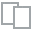
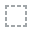
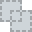
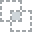
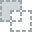
...
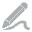
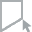
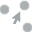
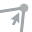
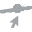

In [10]:
create_report(df.sample(10**3))

# Data transformation

In [11]:
# select label
main_label = 'Percentage'
# drop values with null label
df = df[~df[main_label].isnull()]
# rescale labels
df[main_label] = df[main_label]*100
# filter dates starting from 2022-01-01
df = df[df['Date']>='2022-01-01']
# set up the rare label encoder limiting number of categories to max_n_categories
for col in ['Location_HQ', 'Industry', 'Stage']:
    df[col] = df[col].fillna('Other')
    encoder = RareLabelEncoder(n_categories=1, max_n_categories=50, replace_with='Other', tol=15/df.shape[0])
    df[col] = encoder.fit_transform(df[[col]])
# finally, drop unused columns
cols2drop = ['Company', 'Laid_Off_Count', 'Funds_Raised', 'Date', 'Country']
df = df.drop(cols2drop, axis=1)
print(df.shape)

(1818, 4)


In [12]:
df.sample(5).T

,1183,2784,1831,1620,1216
Location_HQ,New York City,New York City,Seattle,Los Angeles,SF Bay Area
Industry,Infrastructure,Real Estate,Retail,Marketing,Hardware
Percentage,11.0,33.0,19.0,13.0,28.0
Stage,Post-IPO,Unknown,Unknown,Post-IPO,Post-IPO


# Machine learning

In [13]:
# initialize data

y = df[main_label].values.reshape(-1,)
X = df.drop([main_label], axis=1) # drop extra labels
cat_cols = X.select_dtypes(include=['object']).columns
print(cat_cols)
cat_cols_idx = [list(X.columns).index(c) for c in cat_cols]
X_train,X_test,y_train,y_test = train_test_split(X, y, test_size=0.5, random_state=83, stratify=df[['Stage']])
X_train.shape, X_test.shape, y_train.shape, y_test.shape

Index(['Location_HQ', 'Industry', 'Stage'], dtype='object')


((909, 3), (909, 3), (909,), (909,))

In [14]:
# initialize Pool
train_pool = Pool(X_train, 
                  y_train, 
                  cat_features=cat_cols_idx)
test_pool = Pool(X_test,
                 y_test,
                 cat_features=cat_cols_idx)
# specify the training parameters 
model = CatBoostRegressor(iterations=10000,
                          depth=4, 
                          learning_rate=0.03,
                          verbose=0,
                          early_stopping_rounds=100,
                          loss_function='RMSE')
#train the model
model.fit(train_pool, eval_set=test_pool)
# make the prediction using the resulting model
y_train_pred = model.predict(train_pool)
y_test_pred = model.predict(test_pool)

rmse_train = mean_squared_error(y_train, y_train_pred, squared=False)
rmse_test = mean_squared_error(y_test, y_test_pred, squared=False)
print(f"RMSE score for train {round(rmse_train,2)} percentage points, and for test {round(rmse_test,2)} percentage points")

RMSE score for train 24.41 percentage points, and for test 24.56 percentage points


In [15]:
# Baseline scores (assuming the same prediction for all data samples)
rmse_bs_train = mean_squared_error(y_train, [np.mean(y_train)]*len(y_train), squared=False)
rmse_bs_test = mean_squared_error(y_test, [np.mean(y_train)]*len(y_test), squared=False)
print(f"RMSE baseline score for train {round(rmse_bs_train,2)} percentage points, and for test {round(rmse_bs_test,2)} percentage points")

RMSE baseline score for train 28.96 percentage points, and for test 27.55 percentage points


# Explanations with SHAP values

In [16]:
%matplotlib inline

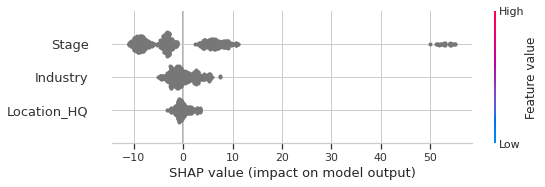

In [17]:
shap.initjs()
ex = shap.TreeExplainer(model)
shap_values = ex.shap_values(X_test)
shap.summary_plot(shap_values, X_test, max_display=30)

In [18]:
expected_values = ex.expected_value
print(f"Average expected probability is {round(expected_values,2)} percentage points")
print(f"Average actual probability is {round(np.mean(y_test),2)} percentage points")

Average expected probability is 27.41 percentage points
Average actual probability is 26.08 percentage points



Location_HQ



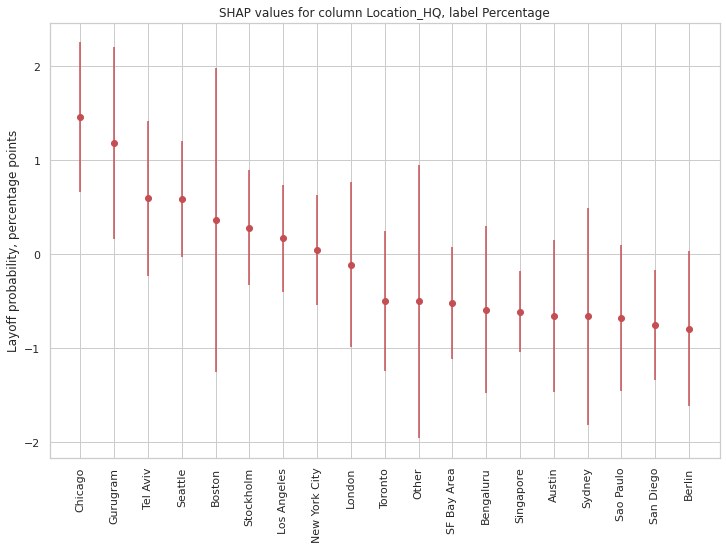

                gain   gain_std  count
col                                   
Chicago        1.4603   0.7940     13 
Gurugram       1.1854   1.0218      8 
Tel Aviv       0.5961   0.8257     26 
Seattle        0.5880   0.6193     31 
Boston         0.3657   1.6144     46 
Stockholm      0.2846   0.6122      8 
Los Angeles    0.1691   0.5672     27 
New York City  0.0445   0.5855     88 
London        -0.1088   0.8799     32 
Toronto       -0.4981   0.7445     20 
Other         -0.4992   1.4532    245 
SF Bay Area   -0.5160   0.5961    229 
Bengaluru     -0.5876   0.8912     42 
Singapore     -0.6120   0.4317     14 
Austin        -0.6564   0.8095      9 
Sydney        -0.6609   1.1529     18 
Sao Paulo     -0.6787   0.7760     19 
San Diego     -0.7562   0.5858      8 
Berlin        -0.7896   0.8247     26 

Industry



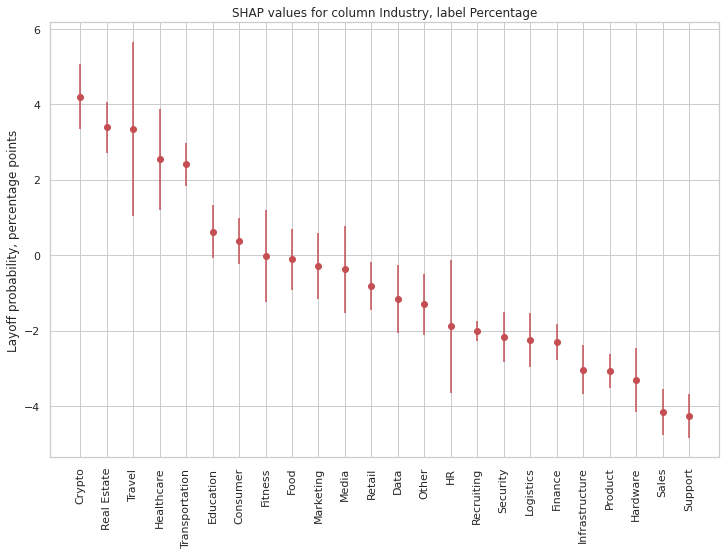

                 gain   gain_std  count
col                                    
Crypto          4.2012   0.8618     58 
Real Estate     3.3849   0.6639     23 
Travel          3.3477   2.2988     16 
Healthcare      2.5408   1.3371     82 
Transportation  2.4052   0.5702     54 
Education       0.6188   0.6985     36 
Consumer        0.3704   0.6062     48 
Fitness        -0.0189   1.2207      8 
Food           -0.1153   0.8170     63 
Marketing      -0.2894   0.8647     40 
Media          -0.3732   1.1510     35 
Retail         -0.8172   0.6325     72 
Data           -1.1610   0.8966     30 
Other          -1.3027   0.8067     87 
HR             -1.8915   1.7561     20 
Recruiting     -2.0041   0.2611      7 
Security       -2.1717   0.6511     45 
Logistics      -2.2539   0.7139     21 
Finance        -2.3005   0.4774    105 
Infrastructure -3.0357   0.6578     11 
Product        -3.0715   0.4398     15 
Hardware       -3.3066   0.8536      8 
Sales          -4.1607   0.6093     15 


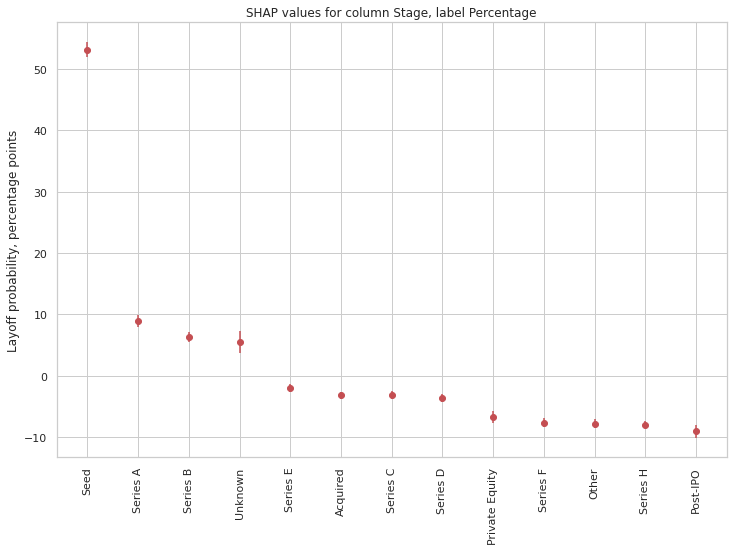

                 gain    gain_std  count
col                                     
Seed            53.1361   1.2364     33 
Series A         8.9493   0.9446     59 
Series B         6.3243   0.7760     95 
Unknown          5.4847   1.7734    142 
Series E        -2.0164   0.6178     46 
Acquired        -3.1616   0.5703     59 
Series C        -3.1669   0.6614     97 
Series D        -3.6739   0.6408     80 
Private Equity  -6.7168   0.9683     15 
Series F        -7.6173   0.7071     27 
Other           -7.7809   0.6968     17 
Series H        -7.9379   0.5032     11 
Post-IPO        -9.0501   1.0097    228 


In [19]:
def show_shap(col, shap_values=shap_values, label=main_label, X_test=X_test):
    df_infl = X_test.copy()
    df_infl['shap_'] = shap_values[:,df_infl.columns.tolist().index(col)]
    gain = round(df_infl.groupby(col).mean()['shap_'],4)
    gain_std = round(df_infl.groupby(col).std()['shap_'],4)
    cnt = df_infl.groupby(col).count()['shap_']
    dd_dict = {'col': list(gain.index), 'gain': list(gain.values), 'gain_std': list(gain_std.values), 'count': cnt}
    df_res = pd.DataFrame.from_dict(dd_dict).sort_values('gain', ascending=False).set_index('col')
    plt.figure(figsize=(12,8))
    plt.errorbar(df_res.index, df_res['gain'], yerr=df_res['gain_std'], fmt="o", color="r")
    plt.title(f'SHAP values for column {col}, label {label}')
    plt.ylabel('Layoff probability, percentage points')
    plt.tick_params(axis="x", rotation=90)
    plt.show();
    print(df_res)
    return

for col in X_test.columns:
    print()
    print(col)
    print()
    show_shap(col, shap_values, label=main_label, X_test=X_test)

<h1 style='background:#afd873; border:10; border-radius: 25px; font-size:250%; font-weight: bold; color:black'><center><a href="https://medium.com/@dima806/employee-layoff-probability-in-2022-shap-values-for-company-funding-stage-location-and-industry-cf3baef6b435">See my paper on Medium.com for more details</a></center></h1> 